<div style = "display: flex; background-color: RGB(255,114,0);">
   <h1 style = "margin: auto; padding: 30px; "> Suite_Brief6_Immo - Simplon Dev IA </h1>
</div>

<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Partie 1 - Librairies et fonctions</h2>
</div>

In [2]:
from google.colab import drive
drive.mount("/content/gdrive")

Mounted at /content/gdrive


In [3]:
import warnings
warnings.filterwarnings('ignore')
import os
import pandas as pd
#from pandas import Series, DataFrame
import numpy as np
import re
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
#%matplotlib qt
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LogisticRegression 
# metric pour calculer: à quel point on juste ou faut
from sklearn.metrics import mean_squared_error

In [4]:
pd.set_option("display.max_columns",43);

In [5]:
df_complet = pd.read_csv('/content/gdrive/MyDrive/P9_immo/valeursfoncieres-2020.txt',delimiter = '|',low_memory=False)
df_copy = df_complet.copy()

In [6]:
df_complet_reduit = df_complet[df_complet.columns[df_complet.isna().sum()/df_complet.shape[0] <0.9]]
df_complet_reduit.head()

,No disposition,Date mutation,Nature mutation,Valeur fonciere,No voie,Type de voie,Code voie,Voie,Code postal,Commune,Code departement,Code commune,Section,No plan,1er lot,Nombre de lots,Code type local,Type local,Surface reelle bati,Nombre pieces principales,Nature culture,Surface terrain
0,1,07/01/2020,Vente,"8000,00",NaN,NaN,B063,FORTUNAT,1250.0,CEYZERIAT,01,72,AK,216,NaN,0,NaN,NaN,NaN,NaN,T,1061.0
1,1,02/01/2020,Vente,"2175,00",NaN,NaN,B124,TERRES DES CINQ SAULES,1290.0,LAIZ,01,203,B,4,NaN,0,NaN,NaN,NaN,NaN,BT,85.0
2,1,02/01/2020,Vente,"2175,00",NaN,NaN,B006,BOIS DU CHAMP RION,1290.0,LAIZ,01,203,B,173,NaN,0,NaN,NaN,NaN,NaN,T,1115.0
3,1,02/01/2020,Vente,"2175,00",NaN,NaN,B025,EN COROBERT,1290.0,LAIZ,01,203,B,477,NaN,0,NaN,NaN,NaN,NaN,T,1940.0
4,1,02/01/2020,Vente,"2175,00",NaN,NaN,B124,TERRES DES CINQ SAULES,1290.0,LAIZ,01,203,C,68,NaN,0,NaN,NaN,NaN,NaN,T,1148.0


In [7]:
df_complet_reduit.isna().sum()

No disposition                     0
Date mutation                      0
Nature mutation                    0
Valeur fonciere                31752
No voie                       990345
Type de voie                 1017945
Code voie                      30948
Voie                           31123
Code postal                    30992
Commune                            0
Code departement                   0
Code commune                       0
Section                          101
No plan                            0
1er lot                      1702571
Nombre de lots                     0
Code type local              1143726
Type local                   1143726
Surface reelle bati          1145290
Nombre pieces principales    1145290
Nature culture                767675
Surface terrain               767675
dtype: int64

In [8]:
df_complet_reduit.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2459560 entries, 0 to 2459559
Data columns (total 22 columns):
 #   Column                     Dtype  
---  ------                     -----  
 0   No disposition             int64  
 1   Date mutation              object 
 2   Nature mutation            object 
 3   Valeur fonciere            object 
 4   No voie                    float64
 5   Type de voie               object 
 6   Code voie                  object 
 7   Voie                       object 
 8   Code postal                float64
 9   Commune                    object 
 10  Code departement           object 
 11  Code commune               int64  
 12  Section                    object 
 13  No plan                    int64  
 14  1er lot                    object 
 15  Nombre de lots             int64  
 16  Code type local            float64
 17  Type local                 object 
 18  Surface reelle bati        float64
 19  Nombre pieces principales  float64
 20  Na

In [85]:
for col in df_complet_reduit.select_dtypes('object'):
    print(f'{col :-<50} {df_complet_reduit[col].unique()}')
print(df_complet_reduit.columns)

Date mutation------------------------------------- ['07/01/2020' '02/01/2020' '09/01/2020' '10/01/2020' '06/01/2020'
 '03/01/2020' '13/01/2020' '08/01/2020' '15/01/2020' '14/01/2020'
 '17/01/2020' '16/01/2020' '21/01/2020' '20/01/2020' '22/01/2020'
 '23/01/2020' '27/01/2020' '24/01/2020' '29/01/2020' '28/01/2020'
 '31/01/2020' '30/01/2020' '03/02/2020' '06/02/2020' '04/02/2020'
 '25/01/2020' '07/02/2020' '08/02/2020' '05/02/2020' '10/02/2020'
 '11/02/2020' '13/02/2020' '14/02/2020' '17/02/2020' '12/02/2020'
 '01/02/2020' '19/02/2020' '21/02/2020' '24/02/2020' '18/02/2020'
 '20/02/2020' '25/02/2020' '27/02/2020' '02/03/2020' '28/02/2020'
 '09/03/2020' '26/02/2020' '06/03/2020' '04/03/2020' '03/03/2020'
 '05/03/2020' '11/03/2020' '10/03/2020' '12/03/2020' '22/02/2020'
 '13/03/2020' '14/03/2020' '16/03/2020' '17/03/2020' '20/03/2020'
 '19/03/2020' '18/03/2020' '23/03/2020' '24/03/2020' '25/03/2020'
 '27/03/2020' '07/03/2020' '31/03/2020' '01/04/2020' '02/04/2020'
 '06/04/2020' '30/03/2020

In [78]:
df_complet_reduit.shape

(2459560, 22)

<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Fonction qui resume tout mon notbook</h2>
</div>

In [51]:
def preprocessing(df_nouveau):
    #df_nouveau = df_nouveau[df_nouveau.columns[df_nouveau.isna().sum()/df_nouveau.shape[0] <0.9]]
    df_nouveau['Date mutation'] = pd.to_datetime(df_nouveau[ 'Date mutation'], format='%d/%m/%Y')
    df_nouveau['year'] = df_nouveau['Date mutation'].dt.year
    df_nouveau['months'] = df_nouveau['Date mutation'].dt.month
    df_nouveau['day'] = df_nouveau['Date mutation'].dt.day
    df_nouveau['Valeur fonciere'] = df_nouveau['Valeur fonciere'].str.replace(',', '.')
    df_nouveau['Valeur fonciere'] = df_nouveau['Valeur fonciere'].astype(float)
    df_nouveau = df_nouveau[df_nouveau['Valeur fonciere']<1000000.00]
    df_nouveau['Code postal'] = df_nouveau['Code postal'].astype(str)
    df_nouveau['Code departement'] = df_nouveau['Code departement'].astype(str)
    df_nouveau = df_nouveau[df_nouveau['Nature mutation'].isin(["Vente","Vente en l'Ã©tat futur d'achÃ¨vement","Vente terrain Ã\xa0 bÃ¢tir"])]
    df_nouveau = df_nouveau[df_nouveau['Type de voie'].isin(['RUE', 'AV'])]
    df_nouveau = df_nouveau[df_nouveau['Type local'].isin(["Maison","Appartement"])]
    df_nouveau = df_nouveau.drop(['Nature culture','Surface terrain', 'year'],axis=1)
    df_nouveau = df_nouveau[df_nouveau['Nombre pieces principales']<10]
    df_nouveau['prix au m2'] = df_nouveau['Valeur fonciere']/df_nouveau['Surface reelle bati']
    #df_nouveau['Type local'] = df_nouveau['Type local'].fillna('mode')
    #df_nouveau['Type local'] = df_nouveau['Type local'].astype(int)
    #df_nouveau = df_nouveau['Type local'].replace(['Appartement','Maison'], [0,1], inplace=True)
    #df_nouveau = df_nouveau['Nature mutation'].replace(['Vente'], [1], inplace=True)
    #df_nouveau['Nature culture'].value_counts(dropna=False)
    #df_nouveau['Surface terrain'].value_counts(dropna=False)
    df_nouveau = df_nouveau.dropna(inplace=False, axis=0)
    return df_nouveau

df_nouveau = df_complet_reduit.copy()
df_nouveau = preprocessing(df_nouveau)

In [52]:
df_nouveau

,No disposition,Date mutation,Nature mutation,Valeur fonciere,No voie,Type de voie,Code voie,Voie,Code postal,Commune,Code departement,Code commune,Section,No plan,1er lot,Nombre de lots,Code type local,Type local,Surface reelle bati,Nombre pieces principales,months,day,prix au m2
14,1,2020-01-06,Vente,54800.0,6.0,AV,0770,DU CHAMP DE FOIRE,1000.0,BOURG-EN-BRESSE,01,53,BK,197,211,2,2.0,Appartement,32.0,1.0,1,6,1712.500000
24,1,2020-01-13,Vente,97000.0,16.0,RUE,1770,DES GRAVES,1000.0,BOURG-EN-BRESSE,01,53,AZ,476,8,1,2.0,Appartement,92.0,3.0,1,13,1054.347826
47,1,2020-01-09,Vente,99000.0,18.0,RUE,1770,DES GRAVES,1000.0,BOURG-EN-BRESSE,01,53,AZ,476,22,1,2.0,Appartement,91.0,4.0,1,9,1087.912088
60,1,2020-01-08,Vente,70000.0,5.0,RUE,1320,EDGAR QUINET,1000.0,BOURG-EN-BRESSE,01,53,AD,381,7,1,2.0,Appartement,45.0,2.0,1,8,1555.555556
77,1,2020-01-07,Vente,143000.0,70.0,RUE,0440,DE LA POSTE,1750.0,SAINT-LAURENT-SUR-SAONE,01,370,A,279,12,3,2.0,Appartement,78.0,3.0,1,7,1833.333333
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2459537,1,2020-12-23,Vente,1.0,37.0,RUE,9318,TIQUETONNE,75002.0,PARIS 02,75,102,AL,124,28,1,2.0,Appartement,31.0,1.0,12,23,0.032258
2459538,1,2020-12-23,Vente,1.0,37.0,RUE,9318,TIQUETONNE,75002.0,PARIS 02,75,102,AL,124,26,1,2.0,Appartement,31.0,2.0,12,23,0.032258
2459539,1,2020-12-29,Vente,355000.0,40.0,RUE,9382,DES TOURNELLES,75004.0,PARIS 04,75,104,AO,93,6,1,2.0,Appartement,32.0,2.0,12,29,11093.750000
2459540,1,2020-12-29,Vente,151000.0,2.0,RUE,1223,BOUTAREL,75004.0,PARIS 04,75,104,AV,115,15,1,2.0,Appartement,10.0,1.0,12,29,15100.000000


In [53]:
# Les 5 premieres lignes de jeu de données
df_nouveau.head(5).T

,14,24,47,60,77
No disposition,1,1,1,1,1
Date mutation,2020-01-06 00:00:00,2020-01-13 00:00:00,2020-01-09 00:00:00,2020-01-08 00:00:00,2020-01-07 00:00:00
Nature mutation,Vente,Vente,Vente,Vente,Vente
Valeur fonciere,54800,97000,99000,70000,143000
No voie,6,16,18,5,70
Type de voie,AV,RUE,RUE,RUE,RUE
Code voie,0770,1770,1770,1320,0440
Voie,DU CHAMP DE FOIRE,DES GRAVES,DES GRAVES,EDGAR QUINET,DE LA POSTE
Code postal,1000.0,1000.0,1000.0,1000.0,1750.0
Commune,BOURG-EN-BRESSE,BOURG-EN-BRESSE,BOURG-EN-BRESSE,BOURG-EN-BRESSE,SAINT-LAURENT-SUR-SAONE


In [54]:
# Voir les 10 dernieres lignes de jeu de données
df_nouveau.tail(10).T

,2459532,2459533,2459534,2459535,2459536,2459537,2459538,2459539,2459540,2459541
No disposition,1,1,1,1,1,1,1,1,1,1
Date mutation,2020-12-23 00:00:00,2020-12-22 00:00:00,2020-12-22 00:00:00,2020-12-21 00:00:00,2020-12-23 00:00:00,2020-12-23 00:00:00,2020-12-23 00:00:00,2020-12-29 00:00:00,2020-12-29 00:00:00,2020-12-23 00:00:00
Nature mutation,Vente,Vente,Vente,Vente,Vente,Vente,Vente,Vente,Vente,Vente
Valeur fonciere,600000,141293,735000,700000,1,1,1,355000,151000,160010
No voie,16,11,7,5,37,37,37,40,2,147
Type de voie,RUE,RUE,RUE,RUE,RUE,RUE,RUE,RUE,RUE,RUE
Code voie,7338,8922,0440,9408,9318,9318,9318,9382,1223,8525
Voie,DU PETIT MUSC,DU SENTIER,D ARGOUT,DE TRACY,TIQUETONNE,TIQUETONNE,TIQUETONNE,DES TOURNELLES,BOUTAREL,SAINT-DENIS
Code postal,75004.0,75002.0,75002.0,75002.0,75002.0,75002.0,75002.0,75004.0,75004.0,75002.0
Commune,PARIS 04,PARIS 02,PARIS 02,PARIS 02,PARIS 02,PARIS 02,PARIS 02,PARIS 04,PARIS 04,PARIS 02


In [55]:
df_nouveau.shape

(222090, 23)

In [13]:
# methode de pandas qui renseigne
df_nouveau.fillna(method='bfill',inplace=True)
df_nouveau.isnull().sum()

No disposition               0
Date mutation                0
Nature mutation              0
Valeur fonciere              0
No voie                      0
Type de voie                 0
Code voie                    0
Voie                         0
Code postal                  0
Commune                      0
Code departement             0
Code commune                 0
Section                      0
No plan                      0
1er lot                      0
Nombre de lots               0
Code type local              0
Type local                   0
Surface reelle bati          0
Nombre pieces principales    0
months                       0
day                          0
dtype: int64

In [56]:
df_nouveau.describe().T

,count,mean,std,min,25%,50%,75%,max
No disposition,222090.0,1.004858,0.109764,1.00000,1.000000,1.0,1.000000,17.0
Valeur fonciere,222090.0,209673.886022,166859.254135,0.15000,99000.000000,160000.0,260000.000000,999800.0
No voie,222090.0,156.235981,931.371728,1.00000,8.000000,21.0,53.000000,9999.0
Code commune,222090.0,190.833567,163.670117,1.00000,68.000000,123.0,278.000000,905.0
No plan,222090.0,273.715696,425.517082,1.00000,60.000000,156.0,342.000000,8316.0
Nombre de lots,222090.0,1.553550,0.760086,1.00000,1.000000,1.0,2.000000,19.0
Code type local,222090.0,1.959125,0.198002,1.00000,2.000000,2.0,2.000000,2.0
Surface reelle bati,222090.0,56.531969,27.284720,1.00000,37.000000,55.0,71.000000,1400.0
Nombre pieces principales,222090.0,2.604440,1.153209,0.00000,2.000000,3.0,3.000000,9.0
months,222090.0,6.394074,3.481907,1.00000,3.000000,6.0,9.000000,12.0


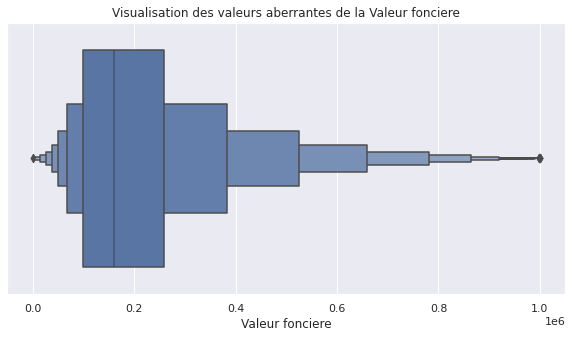

In [59]:
sns.set(rc = {'figure.figsize': (10, 5)}) 
f, axes = plt.subplots()
sns.boxenplot(df_nouveau['Valeur fonciere']);
plt.title("Visualisation des valeurs aberrantes de la Valeur fonciere")
plt.show();

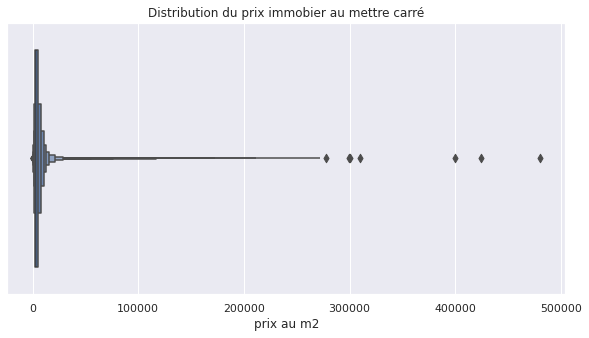

In [58]:
sns.set(rc = {'figure.figsize': (10, 5)}) 
f, axes = plt.subplots()
sns.boxenplot(df_nouveau['prix au m2']);
plt.title("Distribution du prix immobier au mettre carré")
plt.show();

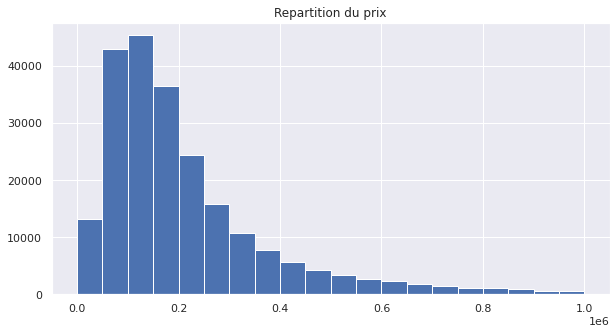

In [60]:
df_nouveau["Valeur fonciere"].hist(bins=20)
plt.title("Repartition du prix")
plt.show()

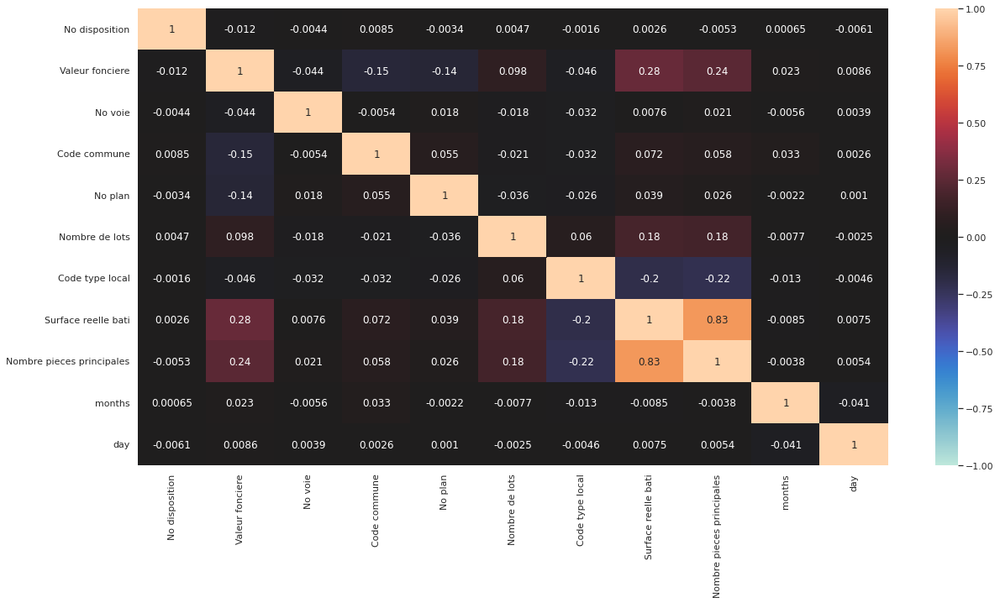

In [24]:
plt.figure(figsize=(20,10))
correlation = df_nouveau.corr()
ax = sns.heatmap(correlation, vmin=-1, vmax=1, center=0, annot=True);

In [27]:
print(df_nouveau['Code departement'].count())
print("**********************")
print(df_nouveau['Code postal'].count())

222090
**********************
222090


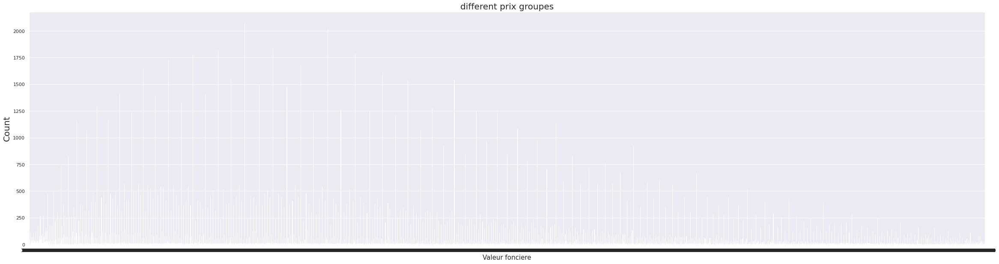

In [30]:
plt.figure(figsize=(40,10))
g = sns.countplot(x="Valeur fonciere", data=df_nouveau, palette='hls')
g.set_title("different prix groupes", fontsize=20);
g.set_xlabel('Valeur fonciere', fontsize=15);
g.set_ylabel('Count', fontsize=20);

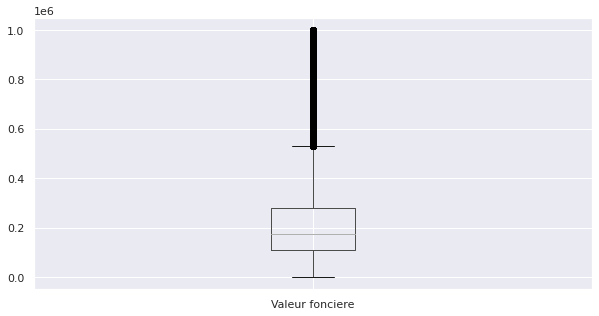

In [43]:
sns.set(rc = {'figure.figsize': (10, 5)}) 
df_nouveau[["Valeur fonciere"]].boxplot();

In [ ]:
plt.figure(figsize = (15,6))
ax = sns.boxplot(x='Type local', y="Valeur fonciere", data=df_nouveau, linewidth=2.5 )

In [26]:
df_nouveau['Code departement'].value_counts()

59     32669
75     23322
77     17577
44     16817
33     16691
       ...  
46       248
12       215
2A       177
971      122
2B         2
Name: Code departement, Length: 97, dtype: int64

In [28]:
del df_nouveau['Section']

In [29]:
for col in df_nouveau.select_dtypes('object'):
    print(f'{col :-<50} {df_nouveau[col].unique()}')

Nature mutation----------------------------------- ['Vente']
Type de voie-------------------------------------- ['RUE' 'AV']
Code voie----------------------------------------- ['0970' '0770' '1770' ... '9834' '7338' '9434']
Voie---------------------------------------------- ['COMTE DE LA TEYSSONNIERE' 'DU CHAMP DE FOIRE' 'DES GRAVES' ...
 'N-D DE BONNE NOUVELLE' 'DE PORT-MAHON' 'DES LIONS SAINT PAUL']
Code postal--------------------------------------- ['1000.0' '1370.0' '1250.0' ... '75020.0' '75004.0' '75002.0']
Commune------------------------------------------- ['BOURG-EN-BRESSE' 'MEILLONNAS' 'CORVEISSIAT' ... 'PARIS 20' 'PARIS 04'
 'PARIS 02']
Code departement---------------------------------- ['01' '02' '03' '04' '05' '06' '07' '08' '09' '10' '11' '12' '13' '14'
 '15' '16' '17' '18' '19' '21' '22' '23' '24' '25' '26' '27' '28' '29'
 '2A' '2B' '30' '31' '32' '33' '34' '35' '36' '37' '38' '39' '40' '41'
 '42' '43' '44' '45' '46' '47' '48' '49' '50' '51' '52' '53' '54' '55'
 '56' '58'

In [55]:
df_nouveau.groupby(['Code postal','Commune','Nombre pieces principales']).agg({'Valeur fonciere':'mean'}).reset_index()

,Code postal,Commune,Nombre pieces principales,Valeur fonciere
0,1000.0,BOURG-EN-BRESSE,1.0,154186.325000
1,1000.0,BOURG-EN-BRESSE,2.0,140379.183099
2,1000.0,BOURG-EN-BRESSE,3.0,140528.740260
3,1000.0,BOURG-EN-BRESSE,4.0,149423.763457
4,1000.0,BOURG-EN-BRESSE,5.0,182617.941176
...,...,...,...,...
71572,nan,GAP,1.0,104300.000000
71573,nan,PRADES-LE-LEZ,3.0,332000.000000
71574,nan,VILLENEUVE EN PERSEIGNE,5.0,180000.000000
71575,nan,VILLENEUVE-LOUBET,1.0,164541.666667


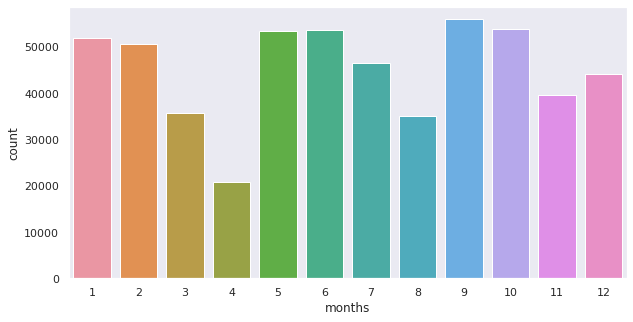

In [48]:
#Visualisation des la ventes en 2020
# Exploitation et visualisation
sns.set(style='dark');
sns.countplot(x="months", data=df_nouveau);


Maison                                      0.401462
Appartement                                 0.305716
Dépendance                                  0.226753
Local industriel. commercial ou assimilé    0.066070
Name: Type local, dtype: float64

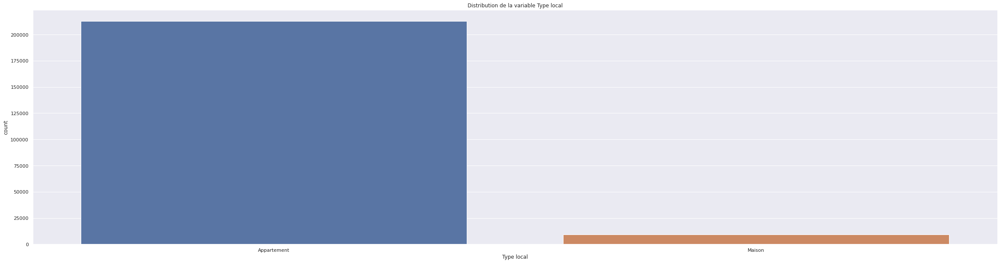

In [33]:
sns.countplot('Type local', data = df_nouveau).set_title("Distribution de la variable Type local");
#CONCLUSION : il faut regler ce probleme avant la Modelisation
df_complet['Type local'].value_counts(normalize = True)

0.0      2.931848e-01
4.0      1.745372e-01
3.0      1.661964e-01
2.0      1.205924e-01
5.0      1.067566e-01
1.0      6.989736e-02
6.0      4.270355e-02
7.0      1.581106e-02
8.0      5.937136e-03
9.0      2.276549e-03
10.0     1.007403e-03
11.0     5.021799e-04
12.0     2.465247e-04
13.0     1.369582e-04
14.0     6.391381e-05
15.0     3.423954e-05
16.0     2.586987e-05
17.0     1.597845e-05
18.0     9.891423e-06
20.0     8.369665e-06
22.0     7.608787e-06
24.0     7.608787e-06
19.0     6.087029e-06
23.0     5.326151e-06
21.0     4.565272e-06
25.0     4.565272e-06
28.0     2.282636e-06
30.0     1.521757e-06
70.0     1.521757e-06
44.0     1.521757e-06
32.0     1.521757e-06
55.0     1.521757e-06
54.0     1.521757e-06
27.0     7.608787e-07
109.0    7.608787e-07
35.0     7.608787e-07
38.0     7.608787e-07
41.0     7.608787e-07
26.0     7.608787e-07
51.0     7.608787e-07
71.0     7.608787e-07
84.0     7.608787e-07
97.0     7.608787e-07
33.0     7.608787e-07
Name: Nombre pieces principales,

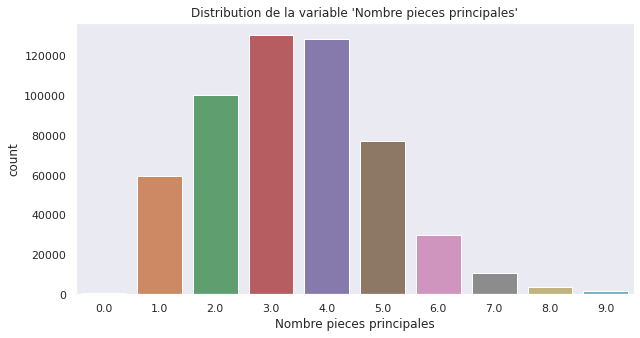

In [50]:
sns.countplot('Nombre pieces principales', data = df_nouveau).set_title("Distribution de la variable 'Nombre pieces principales'");
#CONCLUSION : il faut regler ce probleme avant la Modelisation
df_complet['Nombre pieces principales'].value_counts(normalize = True)

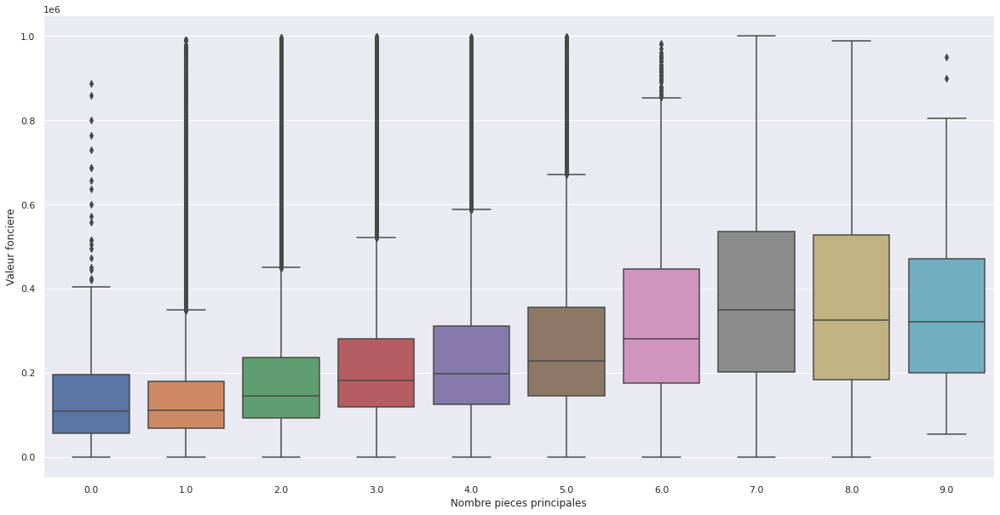

In [31]:
sns.set(rc = {'figure.figsize': (20, 10)}) 
sns.boxplot(x="Nombre pieces principales", y="Valeur fonciere", data=df_nouveau);

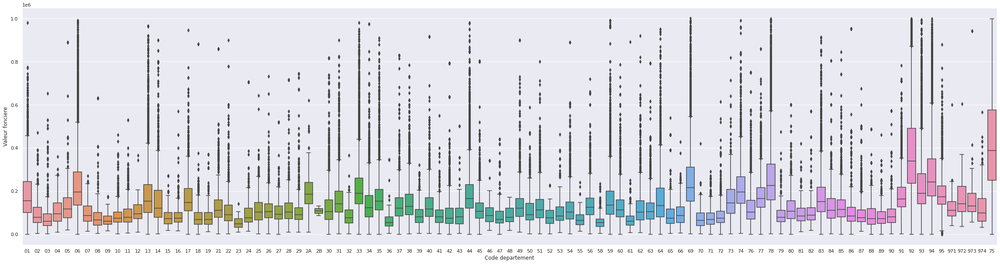

In [32]:
sns.set(rc = {'figure.figsize': (40, 10)}) 
sns.boxplot(x="Code departement", y="Valeur fonciere", data=df_nouveau);

In [40]:
df_nouveau.groupby(['Code postal','Code departement','Nombre pieces principales']).agg({'Valeur fonciere':'mean'})

Valeur fonciere
Code postal Code departement Nombre pieces principales                 
1000.0      01               1.0                          154186.325000
                             2.0                          141526.694444
                             3.0                          142002.876543
                             4.0                          154398.031910
                             5.0                          185882.010714
...                                                                 ...
nan         06               3.0                          365000.000000
            24               2.0                           62000.000000
                             3.0                           82000.000000
            34               3.0                          332000.000000
            72               5.0                          180000.000000

[33681 rows x 1 columns]

In [40]:
df_nouveau.columns

Index(['No disposition', 'Date mutation', 'Nature mutation', 'Valeur fonciere',
       'No voie', 'Type de voie', 'Code voie', 'Voie', 'Code postal',
       'Commune', 'Code departement', 'Code commune', 'Section', 'No plan',
       '1er lot', 'Nombre de lots', 'Code type local', 'Type local',
       'Surface reelle bati', 'Nombre pieces principales', 'months', 'day'],
      dtype='object')

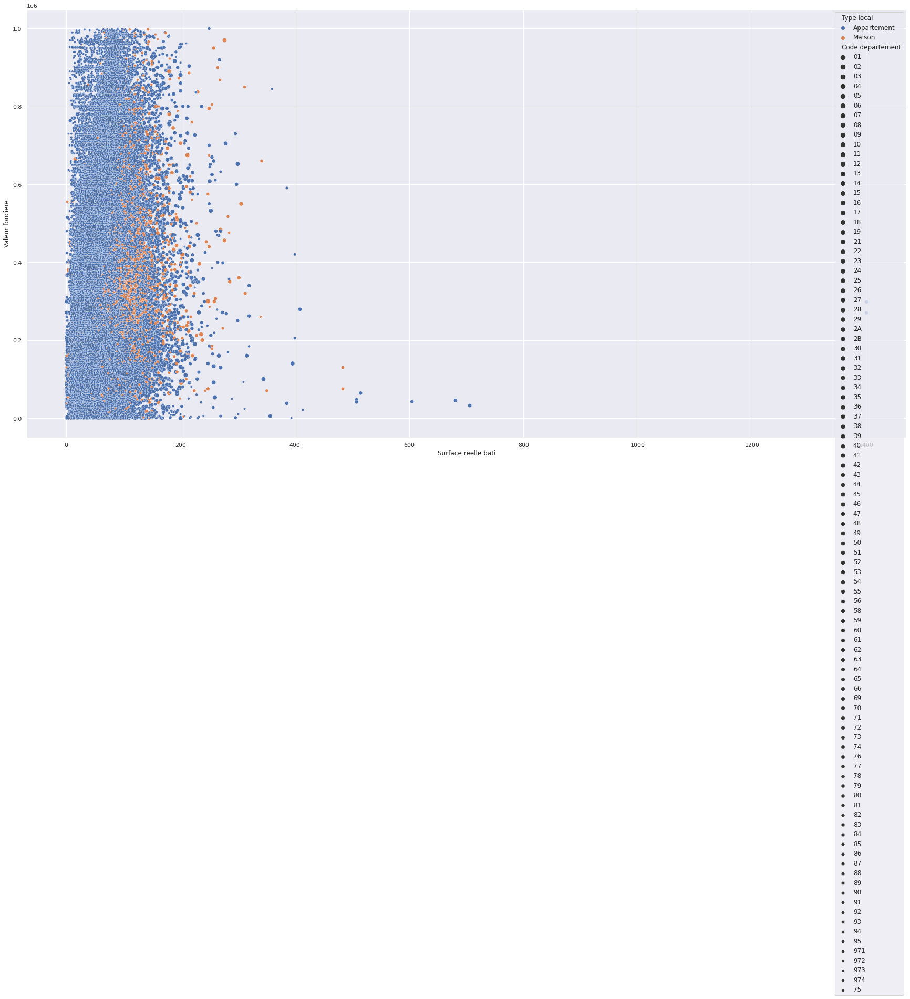

In [41]:
# regroupement avec les region
plt.figure(figsize=(30,15))
sns.scatterplot(x=df_nouveau['Surface reelle bati'], y=df_nouveau['Valeur fonciere'], hue=df_nouveau['Type local'],size=df_nouveau['Code departement']);

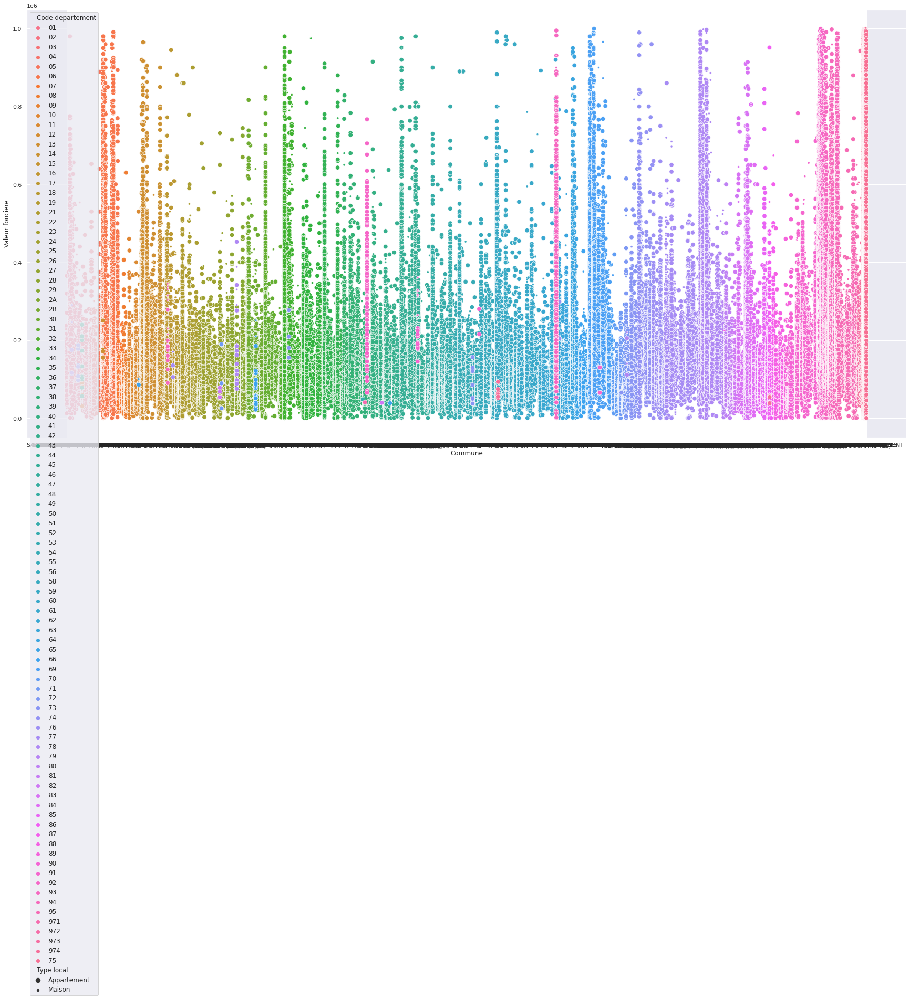

In [42]:
# regroupement avec les region
plt.figure(figsize=(30,15))
sns.scatterplot(x=df_nouveau['Commune'], y=df_nouveau['Valeur fonciere'], hue=df_nouveau['Code departement'],size=df_nouveau['Type local']);

In [39]:
#pip install category_encoders
import category_encoders as ce
df_cat = pd.DataFrame({'VariableCetegoriels':['Code postal','Type local','Commune','Code departement','Nombre pieces principales']})

In [ ]:
copie_df = df_complet.copy()

In [46]:
df_nouveau[::]

,No disposition,Date mutation,Nature mutation,Valeur fonciere,No voie,Type de voie,Code voie,Voie,Code postal,Commune,Code departement,Code commune,Section,No plan,1er lot,Nombre de lots,Code type local,Type local,Surface reelle bati,Nombre pieces principales,months,day
14,1,2020-01-06,Vente,54800.0,6.0,AV,0770,DU CHAMP DE FOIRE,1000.0,BOURG-EN-BRESSE,01,53,BK,197,211,2,2.0,Appartement,32.0,1.0,1,6
24,1,2020-01-13,Vente,97000.0,16.0,RUE,1770,DES GRAVES,1000.0,BOURG-EN-BRESSE,01,53,AZ,476,8,1,2.0,Appartement,92.0,3.0,1,13
47,1,2020-01-09,Vente,99000.0,18.0,RUE,1770,DES GRAVES,1000.0,BOURG-EN-BRESSE,01,53,AZ,476,22,1,2.0,Appartement,91.0,4.0,1,9
60,1,2020-01-08,Vente,70000.0,5.0,RUE,1320,EDGAR QUINET,1000.0,BOURG-EN-BRESSE,01,53,AD,381,7,1,2.0,Appartement,45.0,2.0,1,8
77,1,2020-01-07,Vente,143000.0,70.0,RUE,0440,DE LA POSTE,1750.0,SAINT-LAURENT-SUR-SAONE,01,370,A,279,12,3,2.0,Appartement,78.0,3.0,1,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2459537,1,2020-12-23,Vente,1.0,37.0,RUE,9318,TIQUETONNE,75002.0,PARIS 02,75,102,AL,124,28,1,2.0,Appartement,31.0,1.0,12,23
2459538,1,2020-12-23,Vente,1.0,37.0,RUE,9318,TIQUETONNE,75002.0,PARIS 02,75,102,AL,124,26,1,2.0,Appartement,31.0,2.0,12,23
2459539,1,2020-12-29,Vente,355000.0,40.0,RUE,9382,DES TOURNELLES,75004.0,PARIS 04,75,104,AO,93,6,1,2.0,Appartement,32.0,2.0,12,29
2459540,1,2020-12-29,Vente,151000.0,2.0,RUE,1223,BOUTAREL,75004.0,PARIS 04,75,104,AV,115,15,1,2.0,Appartement,10.0,1.0,12,29


In [111]:
# Voir si il y'a des colonnes qui sont dupliques stricté
print(df_complet_reduit.drop_duplicates().shape)
# Voir le df_reduit à 90% des nan
print("Base de données à 90%",df_complet_reduit.shape)
print("Base de nouveau",df_nouveau.shape)

(2380954, 22)
Base de données à 90% (2459560, 22)
Base de nouveau (222090, 22)


In [100]:
# Voir ce qu'il y'a dans la colonne
df_complet_reduit['Type local'].value_counts()

Maison                                      528257
Appartement                                 402271
Dépendance                                  298369
Local industriel. commercial ou assimilé     86937
Name: Type local, dtype: int64

In [110]:
# Il envele des nan
df_nouveau['Type local'].value_counts(dropna=True)

Appartement    213012
Maison           9078
Name: Type local, dtype: int64

In [ ]:
df_complet_reduit['Type local'].isna().sum()

1143726

In [ ]:
df_filtre_no_voie = df_complet_reduit[df_complet_reduit['Voie']=='TERRES DES CINQ SAULES']

In [ ]:
#**Aller voir dans maps pour les valeurs atypiques extreme**
df_filtre_sur_voie = df_complet_reduit[(df_complet_reduit['Voie']=='TERRES DES CINQ SAULES')& (df_complet_reduit['Valeur fonciere']<1000000)]

In [ ]:
df_complet_reduit.dtypes

No disposition                 int64
Date mutation                 object
Nature mutation               object
Valeur fonciere              float64
No voie                      float64
Type de voie                  object
Code voie                     object
Voie                          object
Code postal                  float64
Commune                       object
Code departement              object
Code commune                   int64
Section                       object
No plan                        int64
1er lot                       object
Nombre de lots                 int64
Code type local              float64
Type local                    object
Surface reelle bati          float64
Nombre pieces principales    float64
Nature culture                object
Surface terrain              float64
dtype: object

In [ ]:
df_type_bien = df_complet_reduit[df_complet_reduit['Type local'].isin(["Maison","Appartement"])]

In [ ]:
# Il y'a des erreur 97 piece dans un Appartement = IMPOSSIBLES
df_complet_reduit['Nombre pieces principales'].unique()
# On peu garde jusqu'a 20 pieces

array([ nan,   2.,   4.,   1.,   7.,   0.,   3.,   5.,   9.,   6.,   8.,
        10.,  11.,  15.,  19.,  16.,  12.,  13.,  14.,  20.,  17.,  23.,
        18.,  22.,  24.,  44.,  55.,  28.,  70.,  33.,  54.,  30.,  21.,
        35.,  25.,  51.,  26.,  27.,  71.,  84., 109.,  38.,  32.,  41.,
        97.])

In [ ]:
df_nouveau['Nombre pieces principales'].unique()

array([2., 4., 1., 3., 5., 9., 6., 7., 8., 0.])

In [ ]:
# Permet d'avoir une idee generale sur nos colonnes
df_complet_reduit.describe()

,No disposition,No voie,Code postal,Code commune,No plan,Nombre de lots,Code type local,Surface reelle bati,Nombre pieces principales,Surface terrain
count,2.459560e+06,1.469215e+06,2.428568e+06,2.459560e+06,2.459560e+06,2.459560e+06,1.315834e+06,1.314270e+06,1.314270e+06,1.691885e+06
mean,1.075359e+00,6.977083e+02,5.178363e+04,2.123115e+02,4.061556e+02,3.914603e-01,1.957431e+00,8.863523e+01,2.501026e+00,2.862449e+03
std,5.593660e-01,2.017514e+03,2.724141e+04,1.688075e+02,5.636461e+02,7.716914e-01,9.437598e-01,7.503979e+02,2.112756e+00,1.609481e+04
min,1.000000e+00,1.000000e+00,1.000000e+03,1.000000e+00,1.000000e+00,0.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,1.000000e+00,8.000000e+00,3.125000e+04,7.800000e+01,8.600000e+01,0.000000e+00,1.000000e+00,1.800000e+01,0.000000e+00,2.260000e+02
50%,1.000000e+00,2.400000e+01,5.070000e+04,1.770000e+02,2.250000e+02,0.000000e+00,2.000000e+00,6.300000e+01,3.000000e+00,5.930000e+02
75%,1.000000e+00,8.800000e+01,7.660000e+04,3.040000e+02,5.050000e+02,1.000000e+00,3.000000e+00,9.600000e+01,4.000000e+00,1.710000e+03
max,7.400000e+01,9.999000e+03,9.749000e+04,9.090000e+02,9.798000e+03,1.500000e+02,4.000000e+00,2.182900e+05,1.090000e+02,1.072309e+07


In [58]:
import plotly.express as px
#Permet de bien voir
#df_complet_reduit['Valeur fonciere_log']= df_complet_reduit['Valeur fonciere'].apply(np.log)

fig = px.box(df_nouveau, x="months", y="Valeur fonciere", hover_data=['Commune','Type local', 'Code departement'])
fig

In [ ]:
# Regarde la commune la plus chere en "Valeur fonciere"
df_complet_reduit['Code postal'].value_counts()
# le code postale le plus VENDU : 51100.0 .Nice

51100.0    6969
54000.0    6252
35000.0    5829
75016.0    5390
6000.0     5341
           ... 
12230.0       1
97140.0       1
20214.0       1
12550.0       1
20243.0       1
Name: Code postal, Length: 5803, dtype: int64

In [ ]:
# le code postale le plus VENDU : 51100.0 .Nice 
# Ensuite c'est NANTES
# Apres BORDEAUX
df_complet_reduit['Commune'].value_counts()

NICE                        17756
NANTES                      14715
BORDEAUX                    12847
LILLE                       10628
RENNES                       9721
                            ...  
VIDOU                           1
LURAIS                          1
GAUDENT                         1
OULCHES LA VALLEE FOULON        1
FOUR                            1
Name: Commune, Length: 29329, dtype: int64

In [ ]:
del df_nouveau['Section']

In [ ]:
df_nouveau.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 677157 entries, 11 to 2459559
Data columns (total 24 columns):
 #   Column                     Non-Null Count   Dtype         
---  ------                     --------------   -----         
 0   No disposition             677157 non-null  int64         
 1   Date mutation              677157 non-null  datetime64[ns]
 2   Nature mutation            677157 non-null  object        
 3   Valeur fonciere            677157 non-null  float64       
 4   No voie                    674077 non-null  float64       
 5   Type de voie               588652 non-null  object        
 6   Code voie                  677157 non-null  object        
 7   Voie                       677094 non-null  object        
 8   Code postal                677157 non-null  object        
 9   Commune                    677157 non-null  object        
 10  Code departement           677157 non-null  object        
 11  Code commune               677157 non-null  int64 

In [ ]:
df_nouveau.shape

(677157, 25)

In [ ]:
pd.set_option("display.max_columns",43);

In [48]:
# Voir par rapport à une commune
df_nouveau[df_nouveau['Commune']=='NICE']

,No disposition,Date mutation,Nature mutation,Valeur fonciere,No voie,Type de voie,Code voie,Voie,Code postal,Commune,Code departement,Code commune,Section,No plan,1er lot,Nombre de lots,Code type local,Type local,Surface reelle bati,Nombre pieces principales,months,day
83637,1,2020-01-03,Vente,616900.0,8.0,RUE,5600,ROSSINI,6000.0,NICE,06,88,LA,312,19,2,2.0,Appartement,98.0,4.0,1,3
83640,1,2020-01-10,Vente,405000.0,1.0,RUE,6570,VALPERGA,6000.0,NICE,06,88,LB,129,4,1,2.0,Appartement,90.0,4.0,1,10
83643,1,2020-01-03,Vente,212550.0,27.0,RUE,3535,LAMARTINE,6000.0,NICE,06,88,LB,299,33,1,2.0,Appartement,95.0,3.0,1,3
83645,1,2020-01-07,Vente,160000.0,5.0,RUE,2295,EMMANUEL PHILIBERT,6300.0,NICE,06,88,KO,73,20,1,2.0,Appartement,34.0,3.0,1,7
83646,1,2020-01-10,Vente,320000.0,28.0,AV,2475,FLORES,6000.0,NICE,06,88,LK,179,7,1,2.0,Appartement,31.0,2.0,1,10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
104828,1,2020-10-26,Vente,180000.0,65.0,AV,2325,ESTIENNE D ORVES,6000.0,NICE,06,88,MK,82,131,2,2.0,Appartement,50.0,3.0,10,26
104838,1,2020-10-29,Vente,208000.0,8.0,AV,5074,PIERRE ISNARD,6200.0,NICE,06,88,OH,389,47,1,2.0,Appartement,72.0,3.0,10,29
104851,1,2020-10-29,Vente,238000.0,23.0,AV,3734,LOUIS CAPPATTI,6200.0,NICE,06,88,OI,362,37,1,2.0,Appartement,48.0,2.0,10,29
104854,1,2020-10-26,Vente,500000.0,276.0,AV,6035,SAINTE MARGUERITE,6200.0,NICE,06,88,OL,212,1,1,1.0,Maison,61.0,4.0,10,26


In [49]:
df_nouveau[df_nouveau['Code departement']== 75].sort_values('prix au m2')[[ 'Valeur fonciere','Commune']]

KeyError: ignored

In [50]:
# Voir par rapport à une commune 'NICE' les ventes selon les date
df_nouveau[df_nouveau['Commune']=='NICE'].sort_values('Date mutation')[['Valeur fonciere', 'Date mutation']]

,Valeur fonciere,Date mutation
83776,210000.0,2020-01-02
98865,445000.0,2020-01-02
98714,370000.0,2020-01-02
98797,390000.0,2020-01-02
83775,117000.0,2020-01-02
...,...,...
98409,230000.0,2020-12-30
98098,130000.0,2020-12-30
97588,125000.0,2020-12-31
98612,190000.0,2020-12-31


In [ ]:
# Voir par rapport à une commune 'NICE' les ventes selon les date
df_nouveau[df_nouveau['Commune']=='LILLE'].sort_values('Date mutation')[['Valeur fonciere','Code postal' ]]

,Valeur fonciere,Code postal
1369171,200000.0,59000.0
1369422,150000.0,59800.0
1370196,85000.0,59260.0
1369139,192000.0,59800.0
1369224,294000.0,59260.0
...,...,...
1382733,85000.0,59000.0
1382675,161000.0,59000.0
1382637,150000.0,59000.0
1382944,92500.0,59260.0


In [ ]:
df_nouveau['Code postal'].value_counts()

51100.0    2443
6000.0     2378
54000.0    1997
72000.0    1875
35000.0    1865
           ... 
36180.0       1
14260.0       1
20172.0       1
20135.0       1
38370.0       1
Name: Code postal, Length: 5753, dtype: int64

In [ ]:
# Voir le prix au mettre carre
df_nouveau['prix au m2'] = df_nouveau['Valeur fonciere']/df_nouveau['Surface reelle bati']
df_nouveau['prix au m2']

11          2057.142857
13          2404.000000
14          1712.500000
22          1073.000000
23          1192.222222
               ...     
2459537        0.032258
2459538        0.032258
2459540    15100.000000
2459541    11429.285714
2459559    12142.857143
Name: prix au m2, Length: 677157, dtype: float64

In [ ]:
df_nouveau['prix au m2'].unique()

array([ 2057.14285714,  2404.        ,  1712.5       , ...,
        9419.53333333, 15100.        , 11429.28571429])

In [ ]:
#df_nouveau[df_nouveau['Commune']=='LILLE']
df_nouveau['Code departement']drop_duplicates

11          1
13          1
14          1
22          1
23          1
           ..
2459537    75
2459538    75
2459540    75
2459541    75
2459559    75
Name: Code departement, Length: 677157, dtype: object

In [ ]:
# moyenne de vente par annee

In [ ]:
# moyenne de vente par mois

In [ ]:
# Faire la moyenne des vente par jour

<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Les visualisation impossable à realiser</h2>
</div>

<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Modelisation pour voir les variables les plus essentielles</h2>
</div>

## Pour X on va recupere les int et float + les colonnes ou il y'a pas beaucoup de null

In [ ]:
y = df_nouveau['Valeur fonciere']
# toutes ces colonnes vont contribie à la prediction du model
# 'prix au m2' : On va eviter de la prendre car la variable a ete contruit à partir de la target: 
# Conclusion : Overtiting
X = df_nouveau[['Surface reelle bati', 'Nombre pieces principales']]

In [ ]:
# Diviser les données on variable Cible et explicatives
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size = 0.3, random_state = 42)

print(X_train.shape)
print(y_train.shape)
print("*******************")
print(X_test.shape)
print(y_test.shape)

(474009, 2)
(474009,)
*******************
(203148, 2)
(203148,)


<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Faire une RandomForest simple</h2>
</div>

In [ ]:
def foretAleatoire(X_train, y_train,X_test, y_test):
    model_regr = RandomForestRegressor(max_depth=5, random_state=0)
    #X_test.fillna(X_train.mean(), inplace=True)
    #X_train.fillna(X_train.mean(), inplace=True)
    model_regr.fit(X_train, y_train)
    y_pred_regr = model_regr.predict(X_test)
    
    print("Voir le Rmse :",mean_squared_error(y_test, y_pred_regr))
    print("score test : ",model_regr.score(X_test, y_test))
    print("score train : ",model_regr.score(X_train, y_train))
    print("variable importante",model_regr.feature_importances_)
    # ZIP pour recupere les features les plus importantes
    for name, feature in zip([ 'Surface reelle bati', 'Nombre pieces principales'], model_regr.feature_importances_):
        print(name, round(feature*100,1))
    return model_regr

<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Le but etant de chercher à savoir quand est ce il fadrait acheter un appartement dans l'année 2020, selon le code postal,...</h2>
</div>

In [ ]:
foretAleatoire(X_train, y_train,X_test, y_test)

Voir le Rmse : 4603156162.42441
score test :  0.09956832028733376
score train :  0.10165048735590199
variable importante [0.77936548 0.22063452]
Surface reelle bati 77.9
Nombre pieces principales 22.1


RandomForestRegressor(max_depth=5, random_state=0)